Реализовать синтезирование лиц из LFW с помощью DCGAN
Библиотеки: [Python, Tensorflow]

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from sklearn.manifold import TSNE
import tensorflow_datasets as tfds
import tensorflow as tf
import codecs
from collections import Counter
import os
import time
import imageio
import cv2

In [2]:
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'
os.environ['TF_ENABLE_GPU_GARBAGE_COLLECTION']='true'

In [3]:
# test gpu
def time_matmul(x):
  start = time.time()
  for loop in range(100):
    tf.matmul(x, x)

  result = time.time()-start

  print("100 циклов: {:0.2f}ms".format(1000*result))

for i in range(2):
    # исполнение CPU
    print(" CPU работает:")
    with tf.device("CPU:0"):
      x = tf.random.uniform([1000, 1000])
      assert x.device.endswith("CPU:0")
      time_matmul(x)

    # исполнение на GPU #0 , если доступен
    if tf.config.experimental.list_physical_devices("GPU"):
      print("GPU работает:")
      with tf.device("GPU:0"): # или GPU:1 , для 2х GPU, GPU:2 для 3х  и т.д.
        x = tf.random.uniform([1000, 1000])
        assert x.device.endswith("GPU:0")
        time_matmul(x)

 CPU работает:
100 циклов: 366.33ms
GPU работает:
100 циклов: 323.29ms
 CPU работает:
100 циклов: 348.32ms
GPU работает:
100 циклов: 6.01ms


## Загрузим данные

In [4]:
train_ds= tfds.load(
    'lfw', 
    as_supervised=True,
    with_info=False,
    split=None,
)['train']

In [5]:
samples = [[x[0], x[1]] for x in iter(train_ds.take(25))]

In [7]:
len(train_ds)

13233

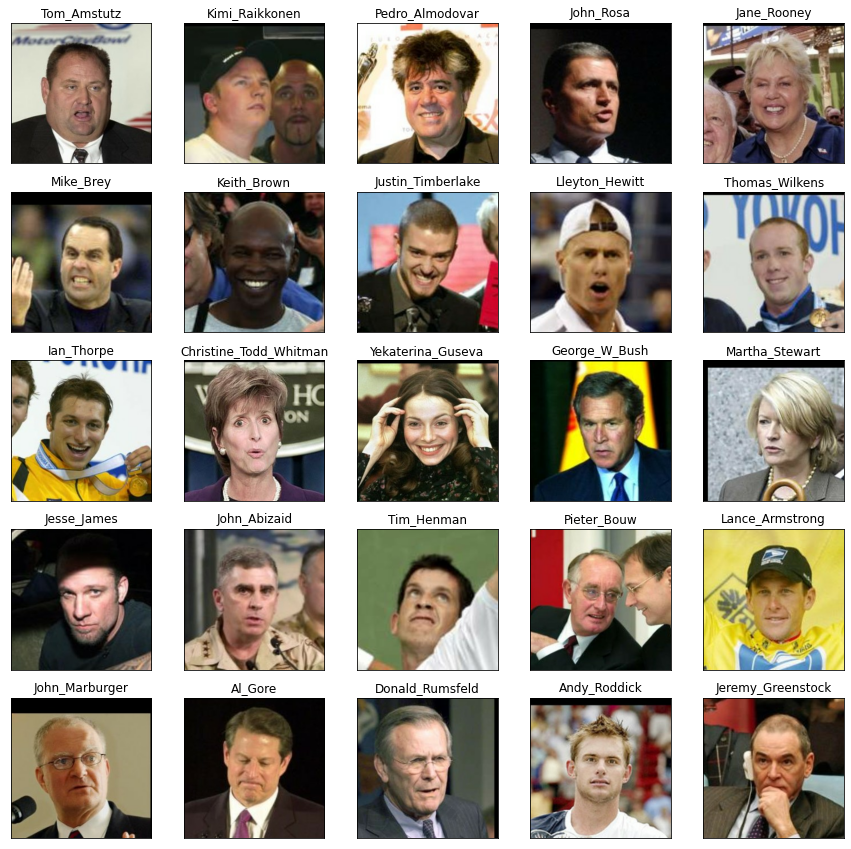

In [8]:
samples = [[x[0], x[1]] for x in iter(train_ds.take(25))]
fig = plt.figure(figsize=(15,15))

for i in range(len(samples)):
  ax = fig.add_subplot(5,5, i+1)
  ax.set_title(samples[i][0].numpy().decode('UTF-8'))
  ax.imshow(samples[i][1])
  plt.xticks([]), plt.yticks([])

plt.show()

## Подготовка пайплайна данных и оптимизатора

In [2]:
def normalization(label, image):
    return (tf.cast(image, tf.float32)-127.5) /  127.5

In [22]:
train_ds= tfds.load(
    'lfw', 
    as_supervised=True,
    with_info=False,
    split=None,
)['train']

In [23]:
INPUT_DIM = 128
NUM_EPOCHS = 20
HALF_BATCH_SIZE = 5
BATCH_SIZE = HALF_BATCH_SIZE * 2
LEARNING_RATE = 0.00001
AUTOTUNE = tf.data.AUTOTUNE

train_x = train_ds.map(normalization)
train_x = train_x.shuffle(buffer_size=len(train_x)+100)
train_x = train_x.repeat(NUM_EPOCHS)
train_x = train_x.batch(HALF_BATCH_SIZE, drop_remainder=True)
train_x = train_x.prefetch(buffer_size=AUTOTUNE)

optimizer = tf.keras.optimizers.Adam(LEARNING_RATE)
sigmoid_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [20]:
train_x

<PrefetchDataset shapes: (5, 250, 250, 3), types: tf.float32>

In [21]:
len(train_x)

26466

## Создадим сети

In [5]:
generator = tf.keras.Sequential([
    tf.keras.layers.Dense(256*63*63),
    tf.keras.layers.LeakyReLU(0.2),
    tf.keras.layers.Reshape((63, 63, 256)),
    tf.keras.layers.Conv2D(128, (3, 3), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(0.2), 
    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(64, (3, 3), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(0.2),    
    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(64, (3, 3), padding='valid'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(0.2),    
    tf.keras.layers.Conv2D(3, (3, 3), padding='same', activation='tanh'),
])

discriminator = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), strides=(2, 2), padding='same'),
    tf.keras.layers.LeakyReLU(0.2),
    tf.keras.layers.Dropout(0.25),    
    tf.keras.layers.Conv2D(64, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.ZeroPadding2D(padding=((0, 1), (0, 1))),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Conv2D(128, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Conv2D(256, kernel_size=3, strides=(1, 1), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1),
])

## Обучение

In [6]:
# Отрисовка
def plot_digits(samples):
    fig = plt.figure(figsize=(15, 15))
    num = samples.shape[0]
    for j in range(num):
        ax = fig.add_subplot(8, 8, j+1)
        ax.imshow(samples[j, ...].reshape(250, 250,3))
        plt.xticks([]), plt.yticks([])
    plt.show()

[Step  0] D Loss: 0.9275; G Loss: 2.5022


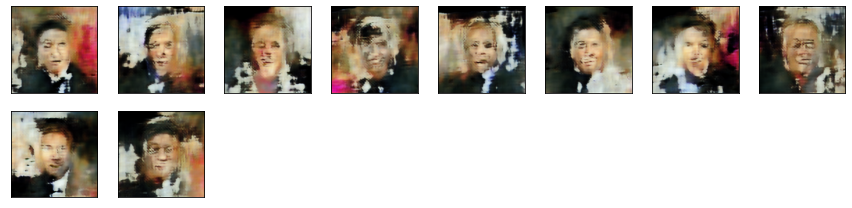

[Step 500] D Loss: 0.4462; G Loss: 1.9164


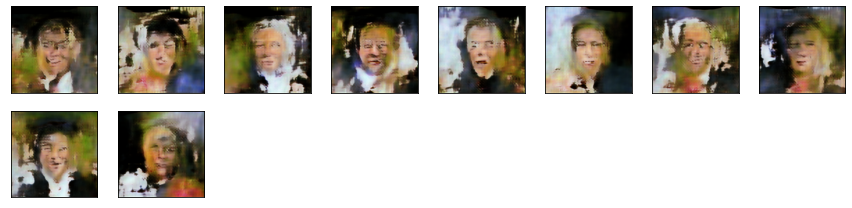

[Step 1000] D Loss: 0.1231; G Loss: 2.6017


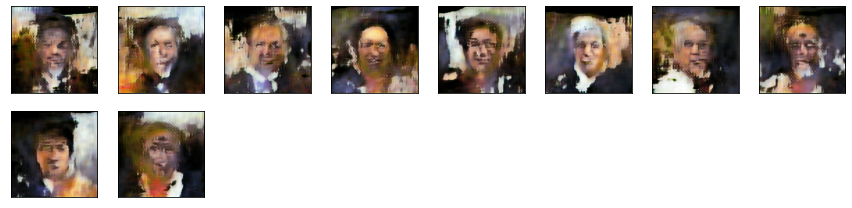

[Step 1500] D Loss: 0.4147; G Loss: 1.9467


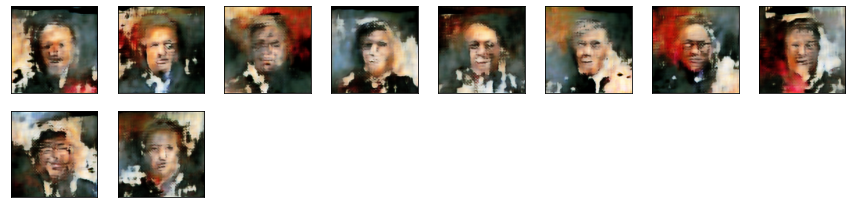

[Step 2000] D Loss: 0.4231; G Loss: 2.3836


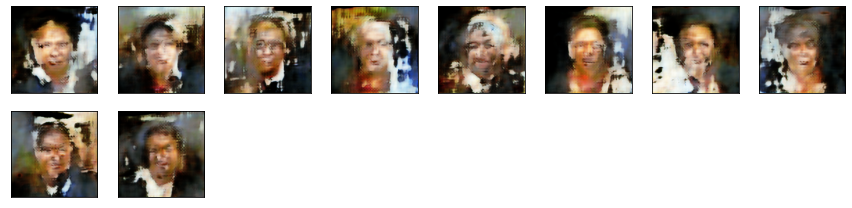

[Step 2500] D Loss: 0.1556; G Loss: 2.9557


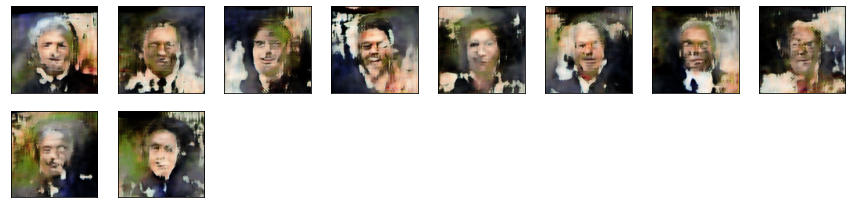

[Step 3000] D Loss: 0.3551; G Loss: 2.6688


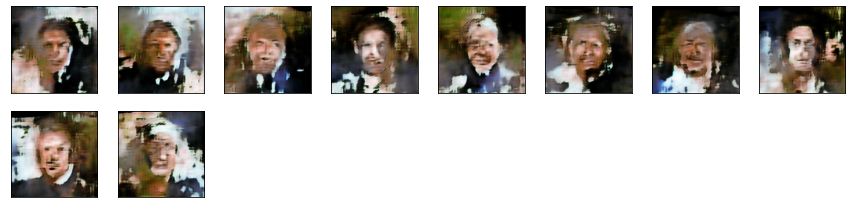

[Step 3500] D Loss: 0.3733; G Loss: 2.4741


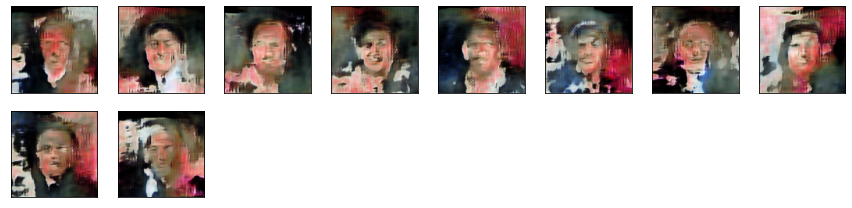

[Step 4000] D Loss: 0.4525; G Loss: 3.1470


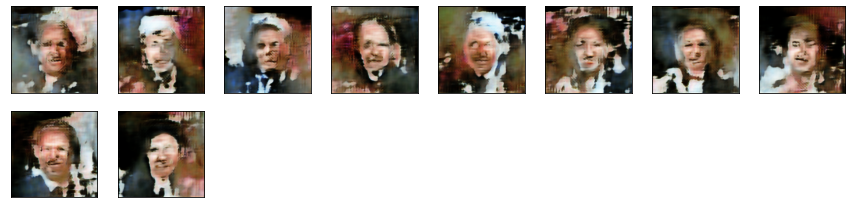

[Step 4500] D Loss: 0.4470; G Loss: 2.3259


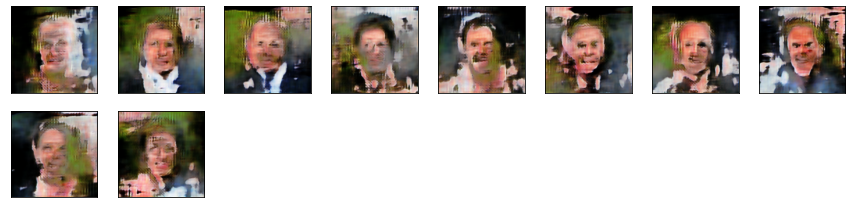

[Step 5000] D Loss: 0.5588; G Loss: 2.4963


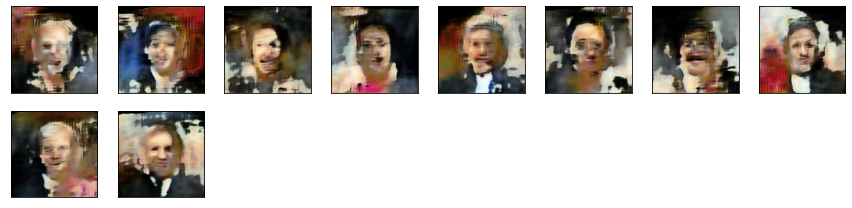

[Step 5500] D Loss: 0.5377; G Loss: 3.3640


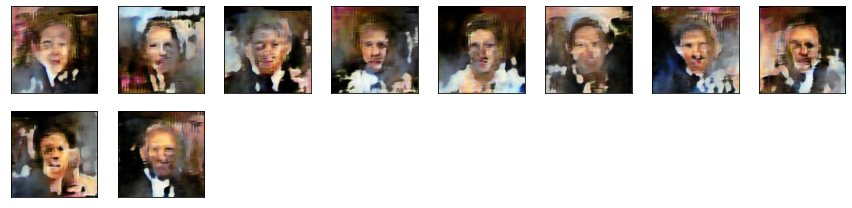

[Step 6000] D Loss: 0.4061; G Loss: 2.4782


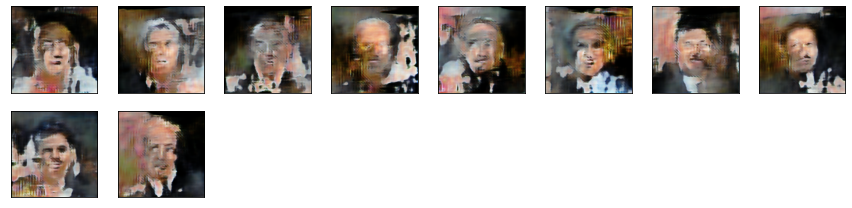

[Step 6500] D Loss: 0.3979; G Loss: 2.8897


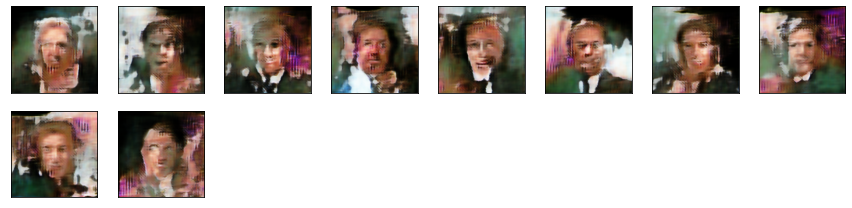

[Step 7000] D Loss: 0.3997; G Loss: 2.7460


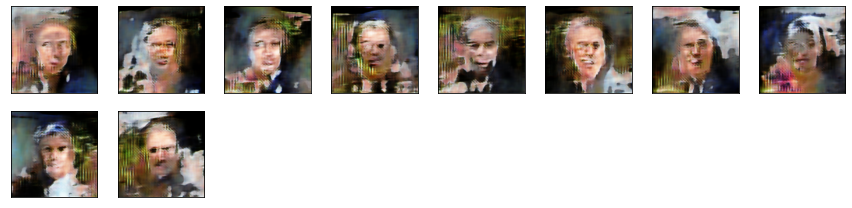

[Step 7500] D Loss: 0.5939; G Loss: 3.1199


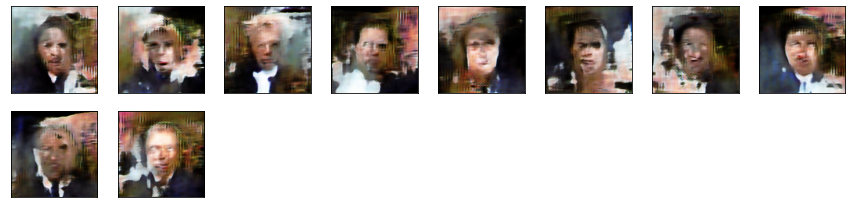

[Step 8000] D Loss: 0.4366; G Loss: 3.7570


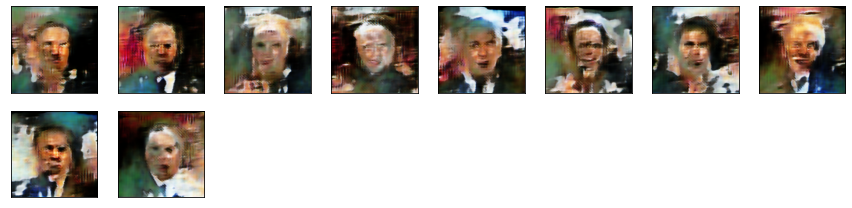

[Step 8500] D Loss: 0.1740; G Loss: 3.7279


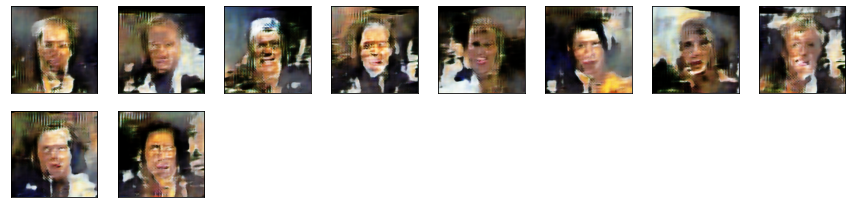

[Step 9000] D Loss: 0.2236; G Loss: 3.2757


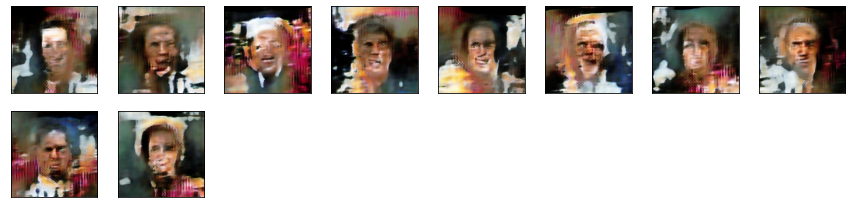

[Step 9500] D Loss: 0.2885; G Loss: 2.8418


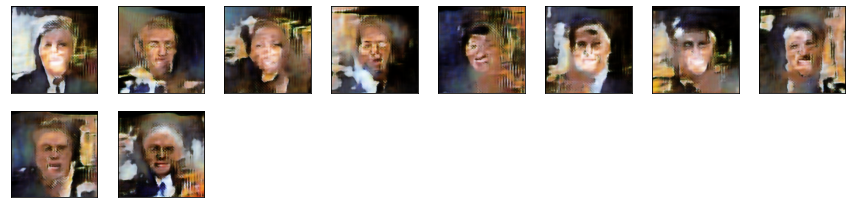

[Step 10000] D Loss: 0.2301; G Loss: 3.4616


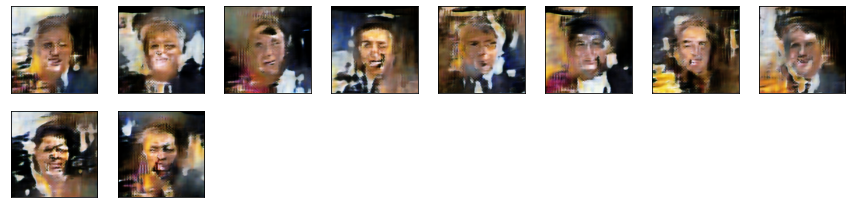

[Step 10500] D Loss: 0.3073; G Loss: 3.5278


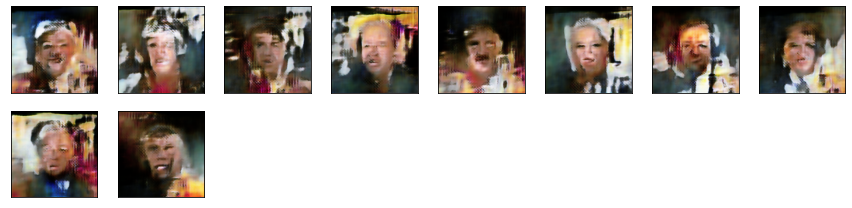

[Step 11000] D Loss: 0.4925; G Loss: 3.7976


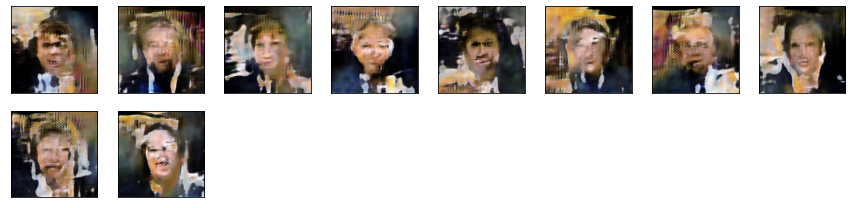

[Step 11500] D Loss: 0.3778; G Loss: 3.4462


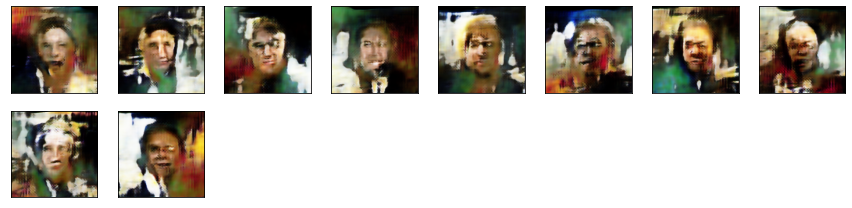

[Step 12000] D Loss: 0.6689; G Loss: 2.3697


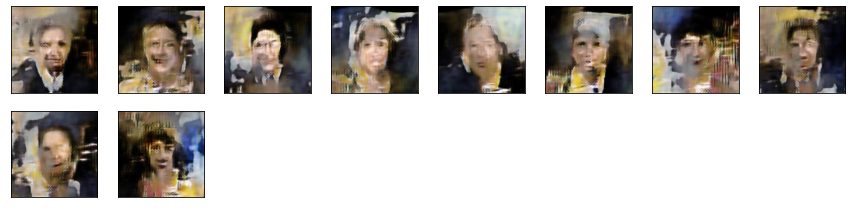

[Step 12500] D Loss: 0.2373; G Loss: 4.4867


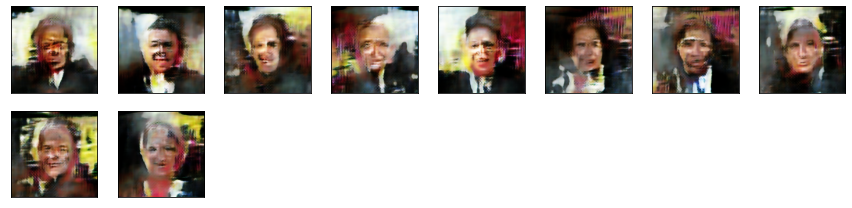

[Step 13000] D Loss: 0.1599; G Loss: 3.7866


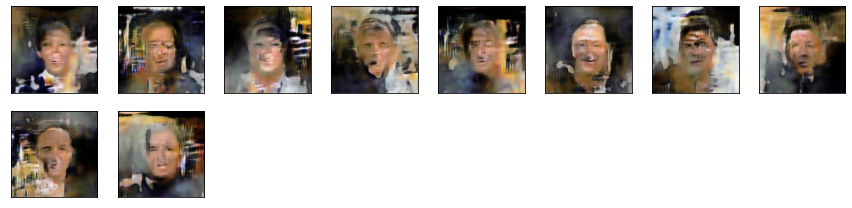

[Step 13500] D Loss: 0.2661; G Loss: 3.4066


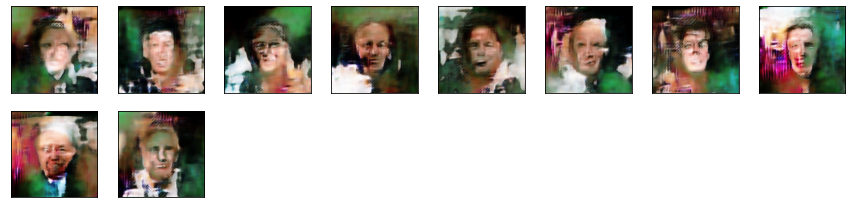

[Step 14000] D Loss: 0.2749; G Loss: 3.2196


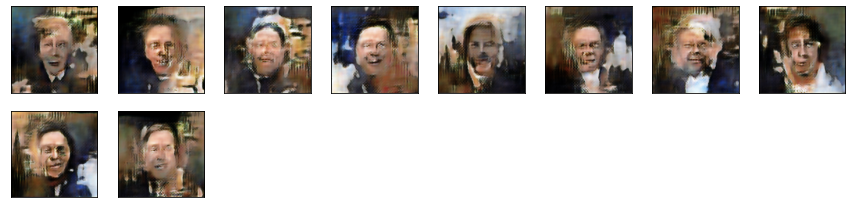

[Step 14500] D Loss: 0.7971; G Loss: 3.6252


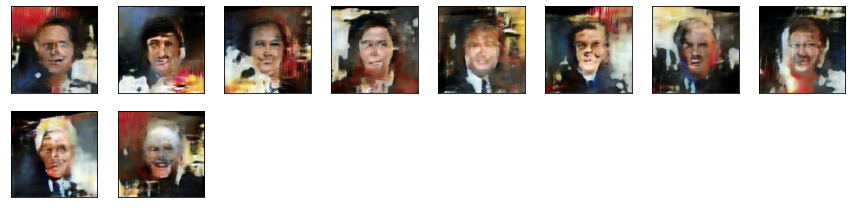

[Step 15000] D Loss: 0.2376; G Loss: 2.9888


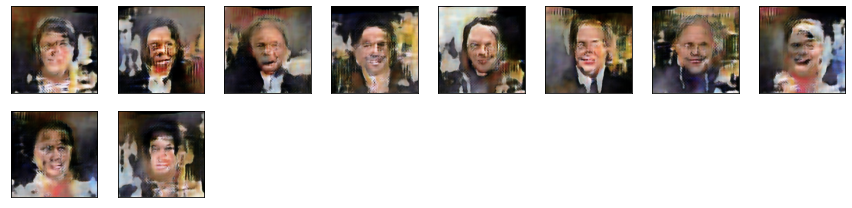

[Step 15500] D Loss: 0.5432; G Loss: 2.6495


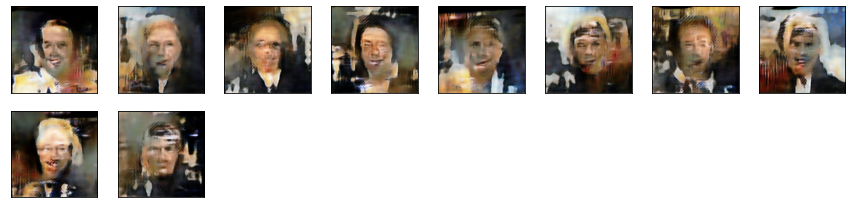

[Step 16000] D Loss: 0.7072; G Loss: 3.6285


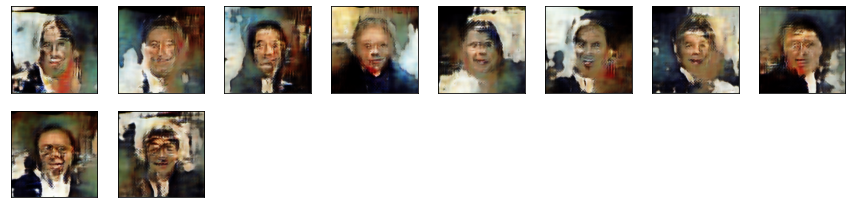

[Step 16500] D Loss: 0.3522; G Loss: 3.1193


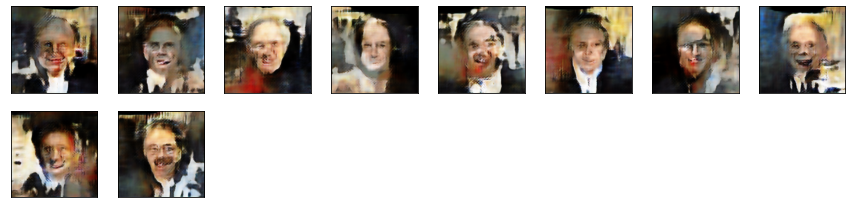

[Step 17000] D Loss: 0.4437; G Loss: 2.6493


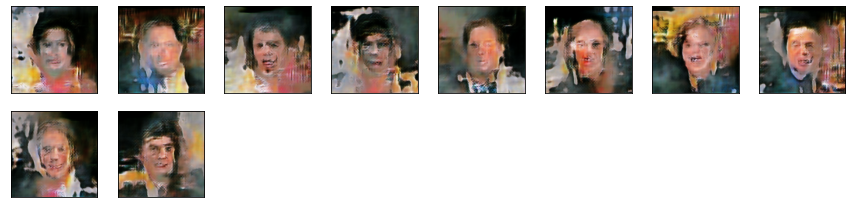

[Step 17500] D Loss: 0.9939; G Loss: 3.0815


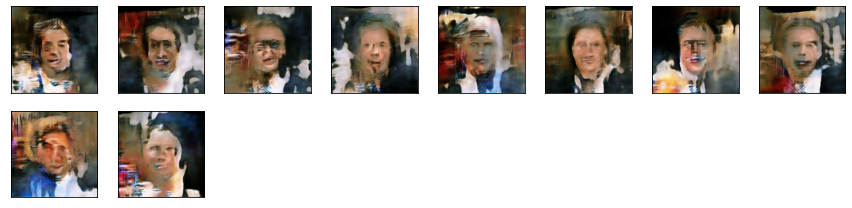

[Step 18000] D Loss: 0.9591; G Loss: 2.5252


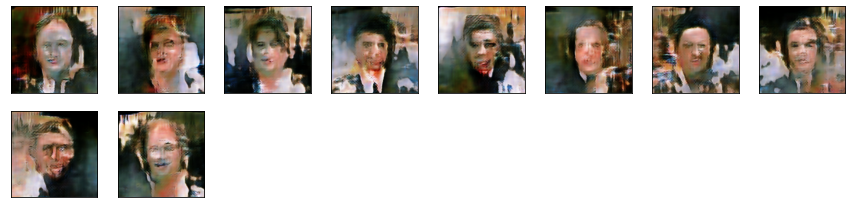

[Step 18500] D Loss: 0.9132; G Loss: 2.5404


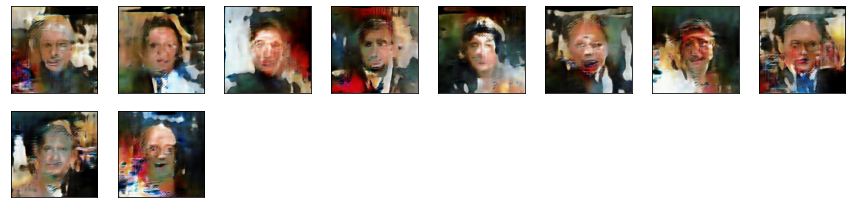

[Step 19000] D Loss: 0.3016; G Loss: 3.3532


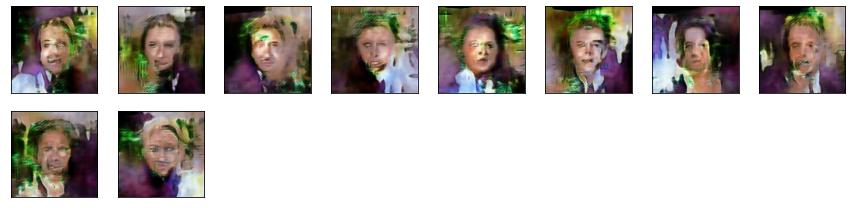

[Step 19500] D Loss: 0.4135; G Loss: 2.9097


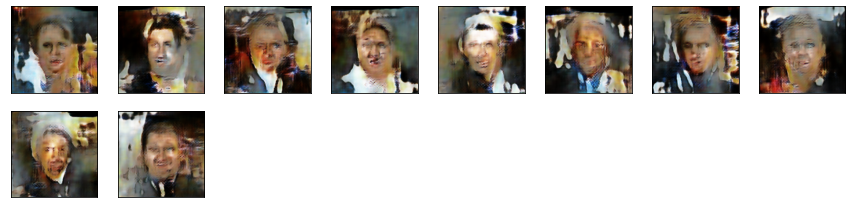

[Step 20000] D Loss: 0.3640; G Loss: 3.3503


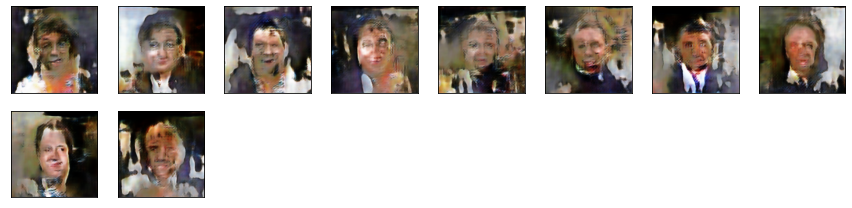

[Step 20500] D Loss: 0.3939; G Loss: 2.6914


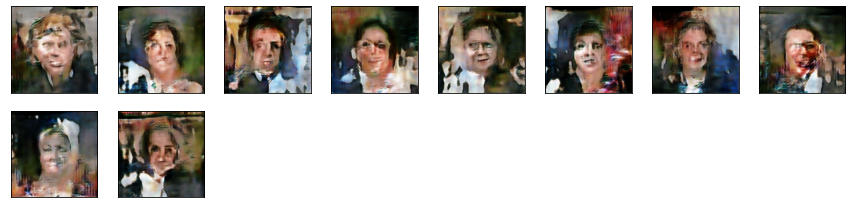

[Step 21000] D Loss: 0.7768; G Loss: 2.5912


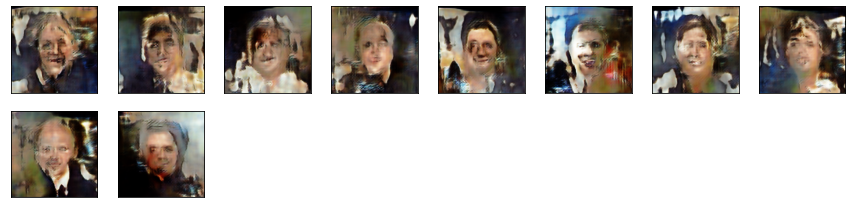

[Step 21500] D Loss: 0.3514; G Loss: 3.8336


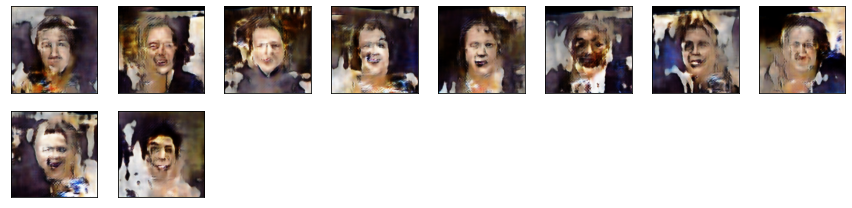

[Step 22000] D Loss: 0.2646; G Loss: 3.3107


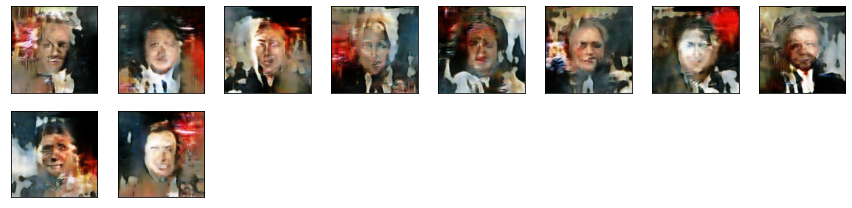

[Step 22500] D Loss: 0.9038; G Loss: 3.1044


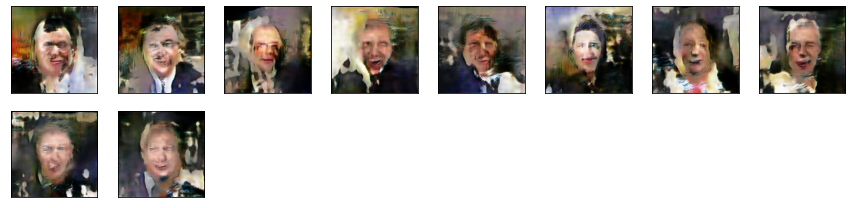

[Step 23000] D Loss: 0.3229; G Loss: 2.7692


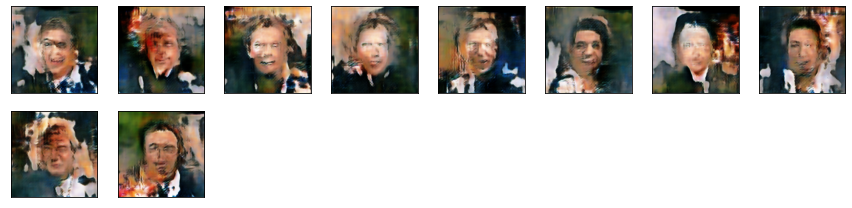

[Step 23500] D Loss: 0.6370; G Loss: 3.3407


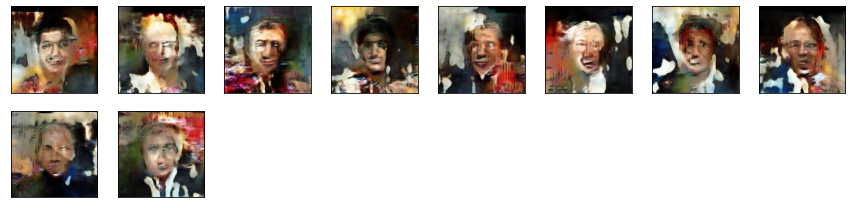

[Step 24000] D Loss: 0.3058; G Loss: 2.6747


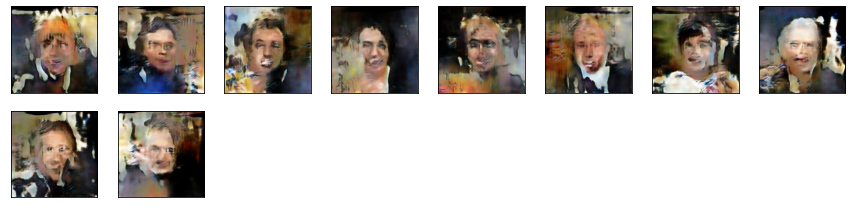

[Step 24500] D Loss: 0.3564; G Loss: 3.0250


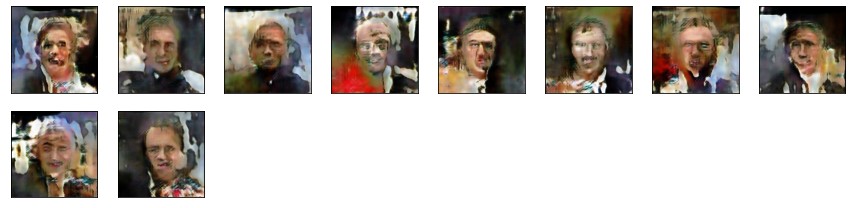

[Step 25000] D Loss: 0.3767; G Loss: 2.2490


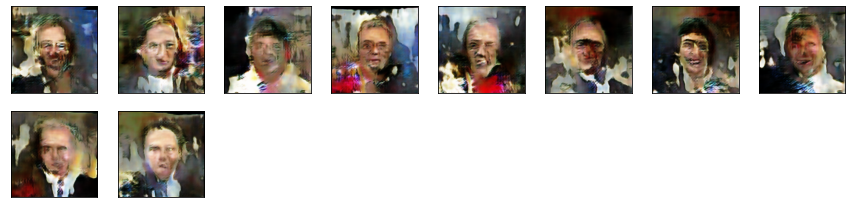

[Step 25500] D Loss: 0.1351; G Loss: 2.6888


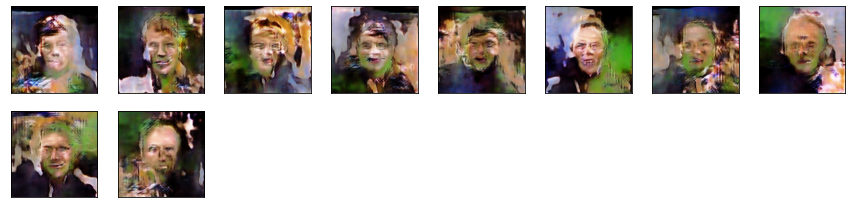

[Step 26000] D Loss: 0.5455; G Loss: 2.6386


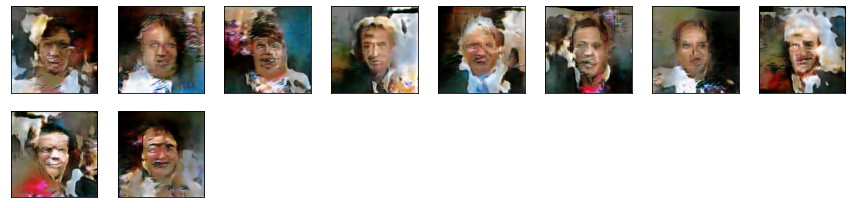

[Step 26500] D Loss: 0.6272; G Loss: 2.8393


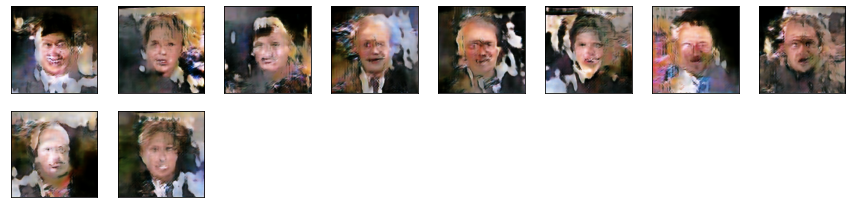

[Step 27000] D Loss: 0.5949; G Loss: 2.1327


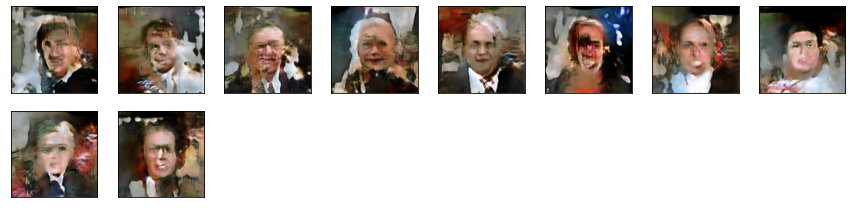

[Step 27500] D Loss: 0.5592; G Loss: 2.7886


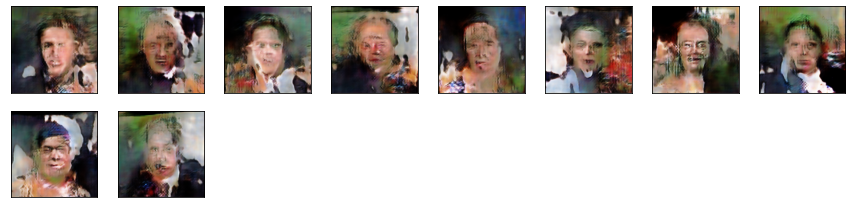

[Step 28000] D Loss: 0.8600; G Loss: 2.6341


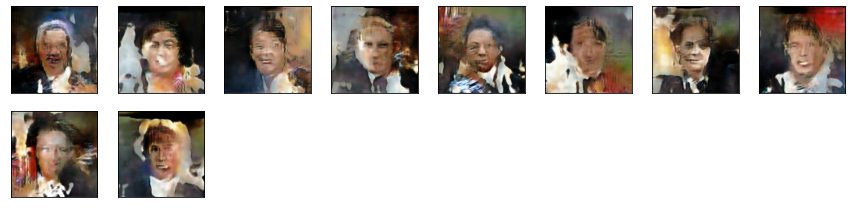

[Step 28500] D Loss: 0.5030; G Loss: 2.6465


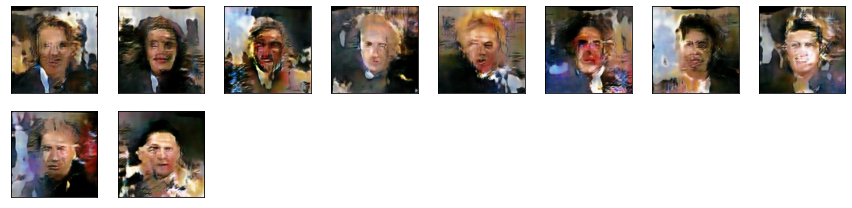

[Step 29000] D Loss: 0.3111; G Loss: 2.5089


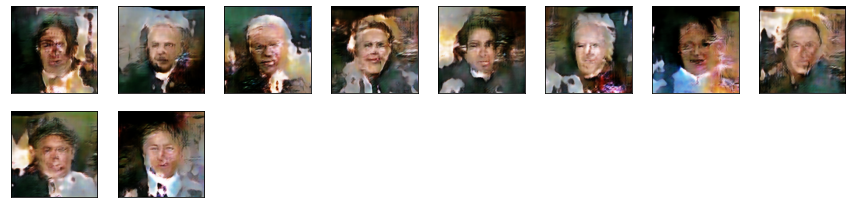

[Step 29500] D Loss: 0.5943; G Loss: 2.1295


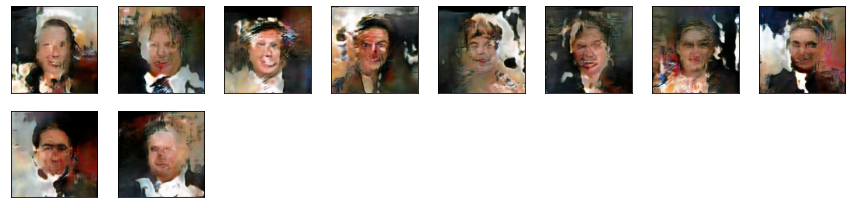

[Step 30000] D Loss: 0.3117; G Loss: 2.7592


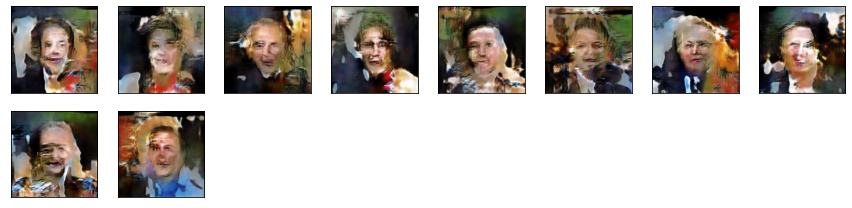

[Step 30500] D Loss: 0.4738; G Loss: 2.5127


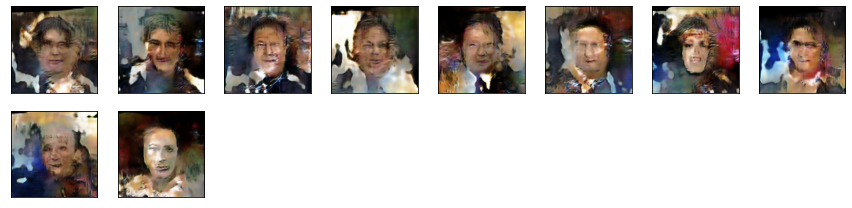

[Step 31000] D Loss: 0.5973; G Loss: 2.5993


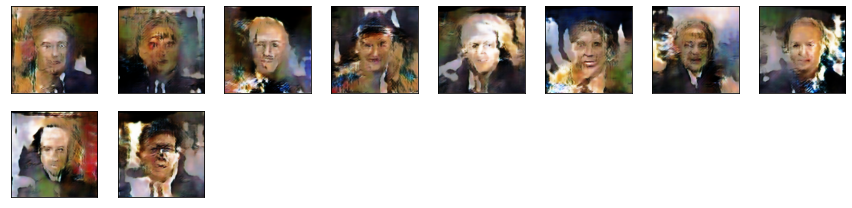

[Step 31500] D Loss: 0.1904; G Loss: 1.5845


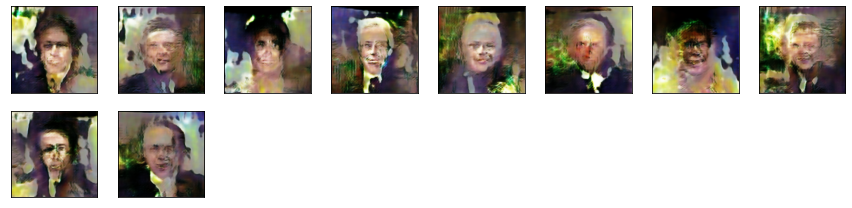

[Step 32000] D Loss: 0.1640; G Loss: 2.1694


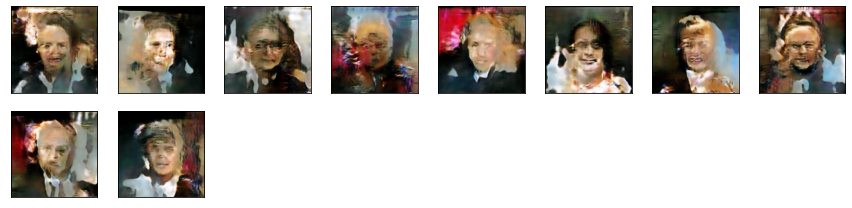

[Step 32500] D Loss: 0.6700; G Loss: 2.7424


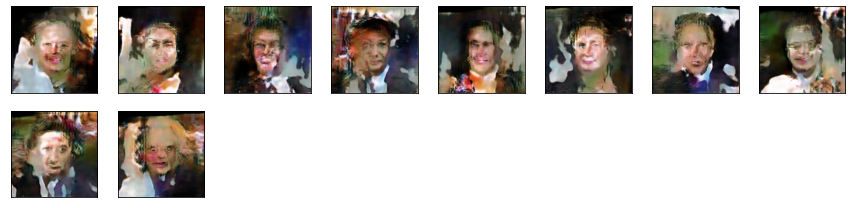

[Step 33000] D Loss: 0.3269; G Loss: 2.3349


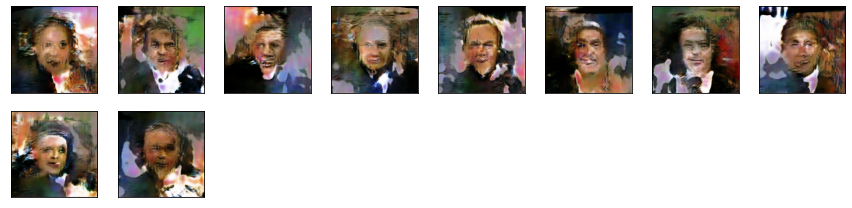

[Step 33500] D Loss: 0.3906; G Loss: 2.6034


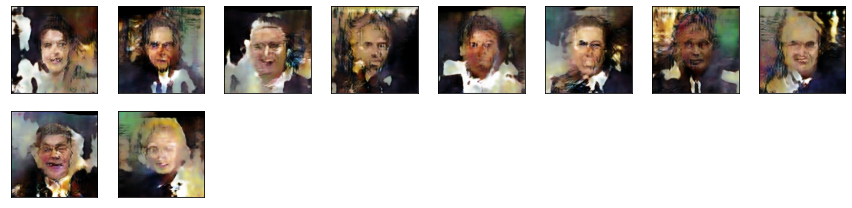

[Step 34000] D Loss: 0.3622; G Loss: 2.4347


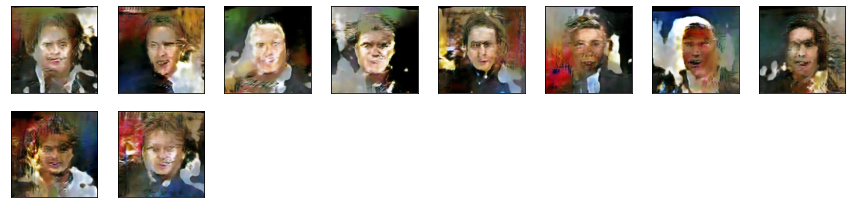

[Step 34500] D Loss: 0.4503; G Loss: 2.2761


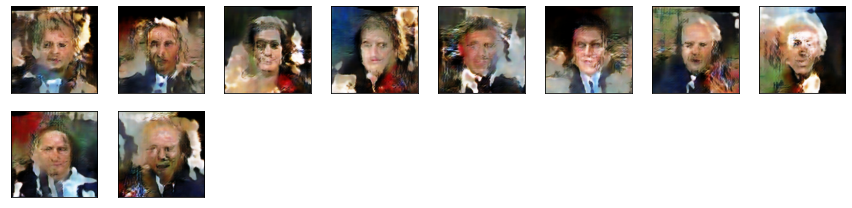

[Step 35000] D Loss: 0.5552; G Loss: 1.8260


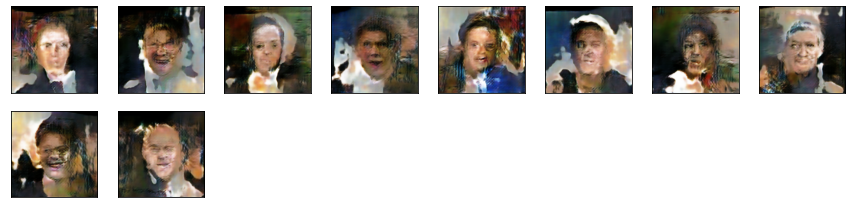

[Step 35500] D Loss: 0.4218; G Loss: 2.3466


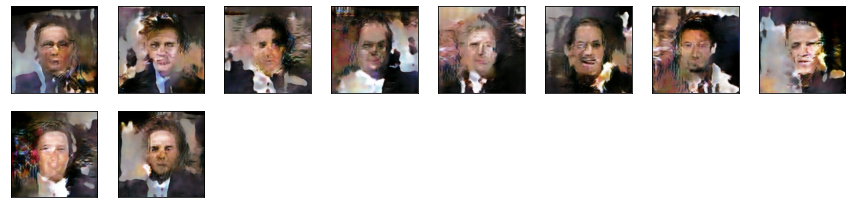

[Step 36000] D Loss: 0.4006; G Loss: 2.1524


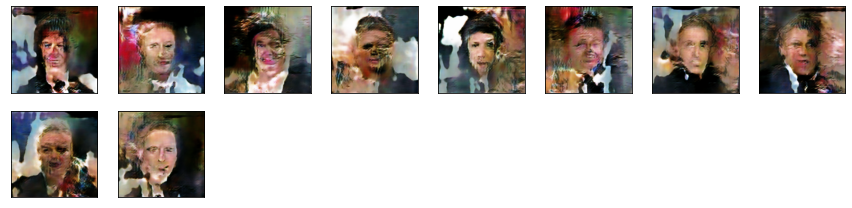

[Step 36500] D Loss: 0.5298; G Loss: 1.5710


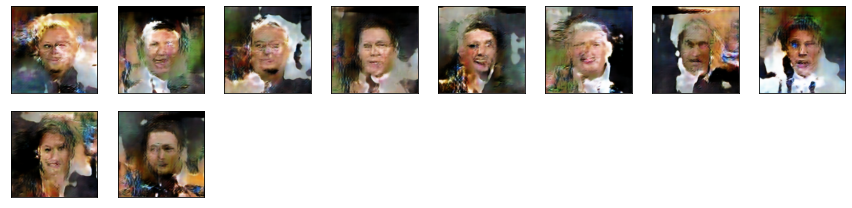

[Step 37000] D Loss: 0.3895; G Loss: 2.4276


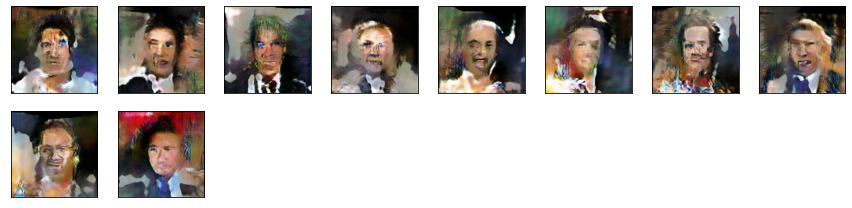

[Step 37500] D Loss: 0.5396; G Loss: 2.3715


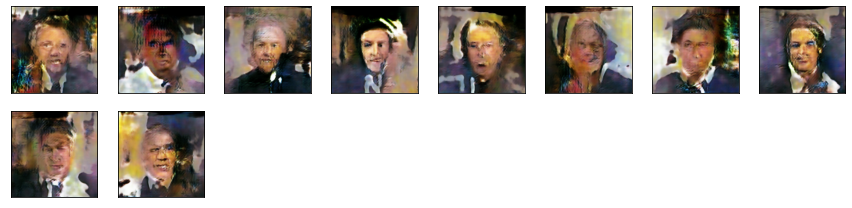

[Step 38000] D Loss: 0.3660; G Loss: 2.0978


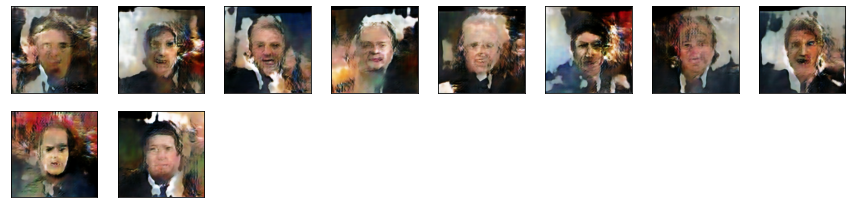

[Step 38500] D Loss: 0.6809; G Loss: 1.7346


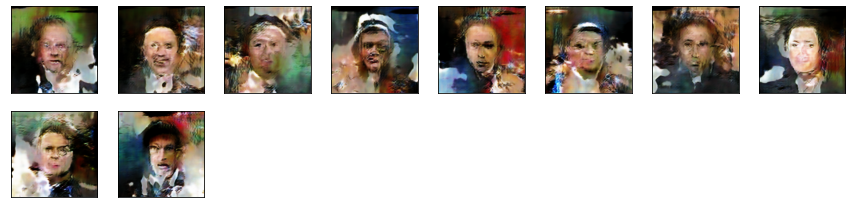

[Step 39000] D Loss: 1.1243; G Loss: 2.2089


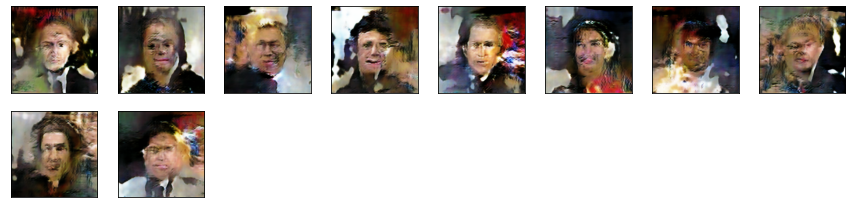

[Step 39500] D Loss: 0.6064; G Loss: 2.1935


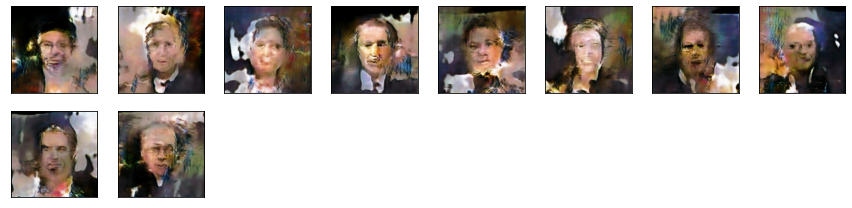

[Step 40000] D Loss: 0.4634; G Loss: 1.7520


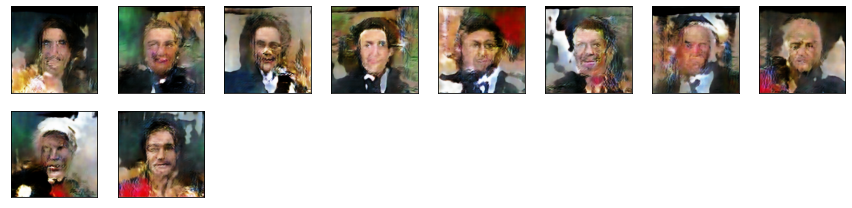

[Step 40500] D Loss: 0.8702; G Loss: 2.6013


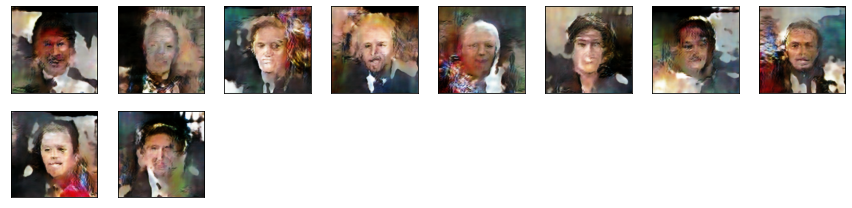

[Step 41000] D Loss: 0.7801; G Loss: 2.3766


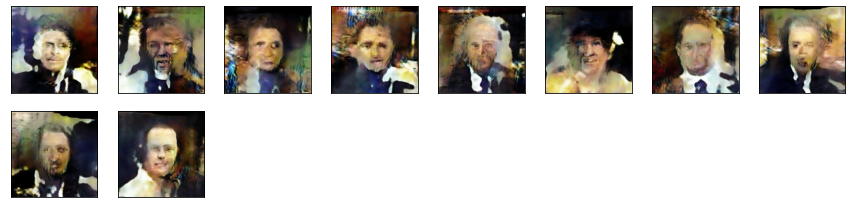

[Step 41500] D Loss: 0.6000; G Loss: 2.3736


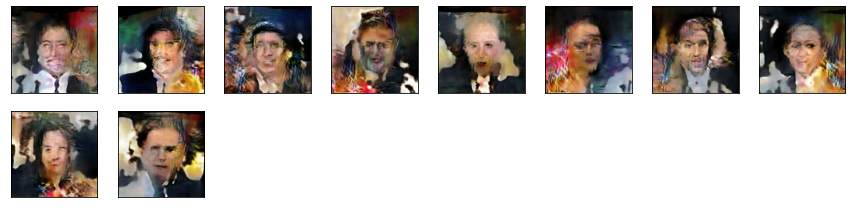

[Step 42000] D Loss: 0.3220; G Loss: 2.3783


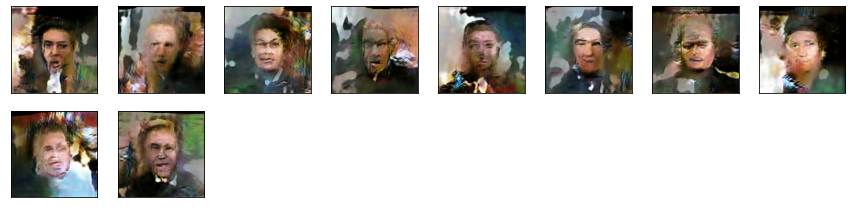

[Step 42500] D Loss: 0.5265; G Loss: 2.3157


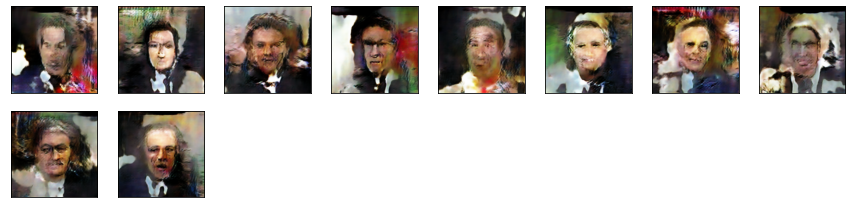

[Step 43000] D Loss: 0.3289; G Loss: 2.3883


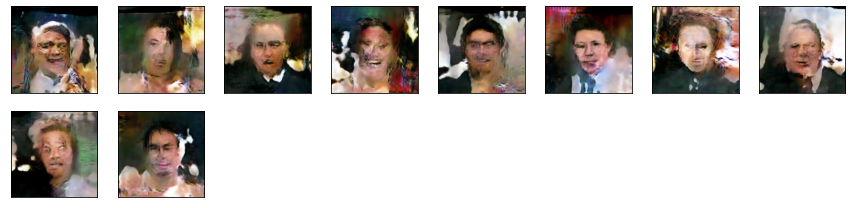

[Step 43500] D Loss: 0.4593; G Loss: 2.0204


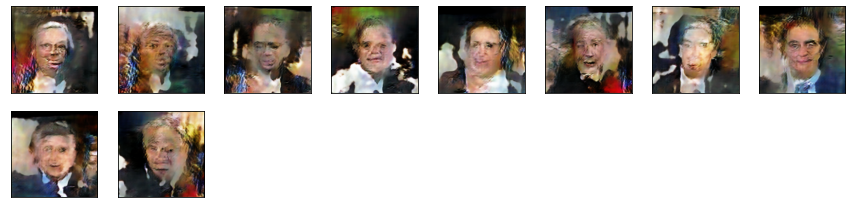

[Step 44000] D Loss: 0.5104; G Loss: 2.0957


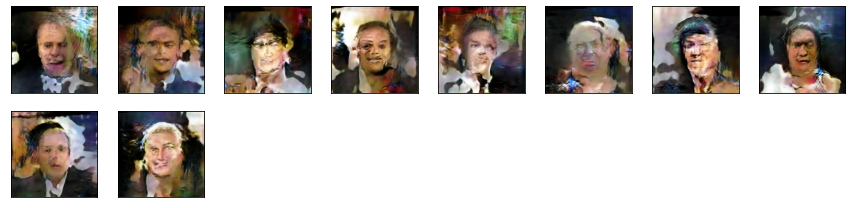

[Step 44500] D Loss: 0.9653; G Loss: 1.9181


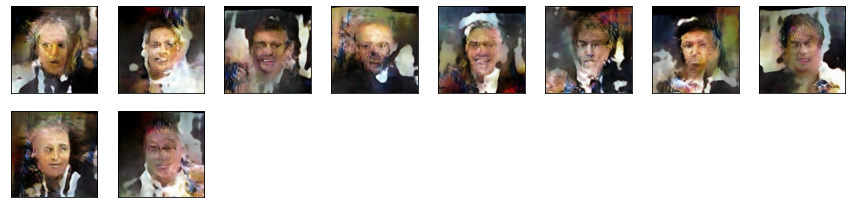

[Step 45000] D Loss: 0.3745; G Loss: 2.0448


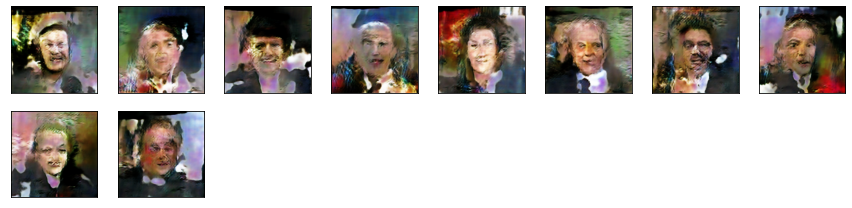

[Step 45500] D Loss: 0.4952; G Loss: 2.3524


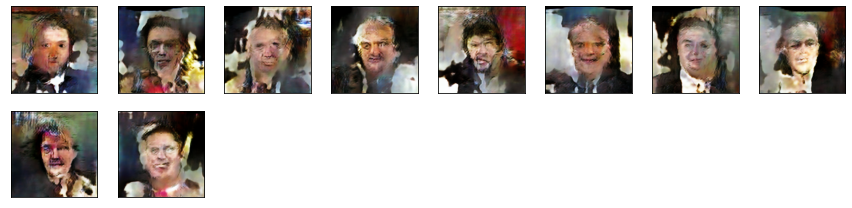

[Step 46000] D Loss: 0.7034; G Loss: 1.9864


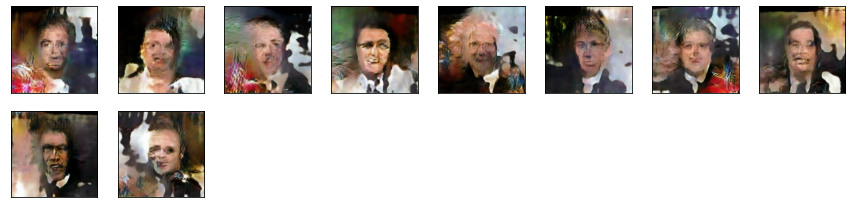

[Step 46500] D Loss: 0.4079; G Loss: 1.8169


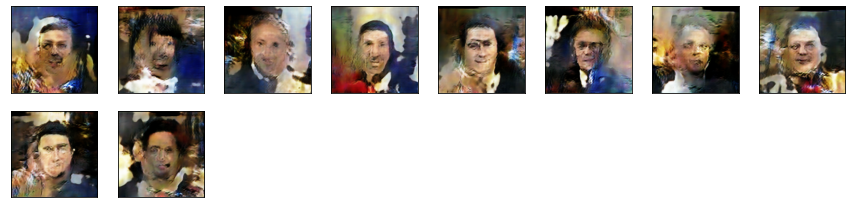

[Step 47000] D Loss: 0.5241; G Loss: 2.7403


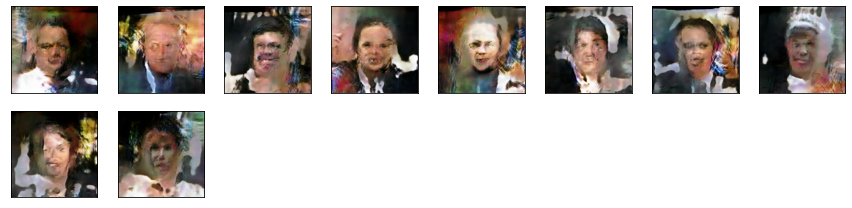

[Step 47500] D Loss: 0.4696; G Loss: 2.3504


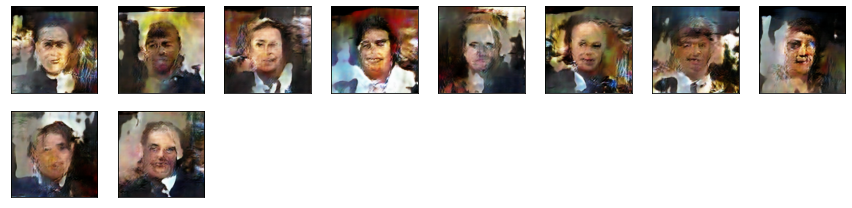

[Step 48000] D Loss: 0.7994; G Loss: 1.9933


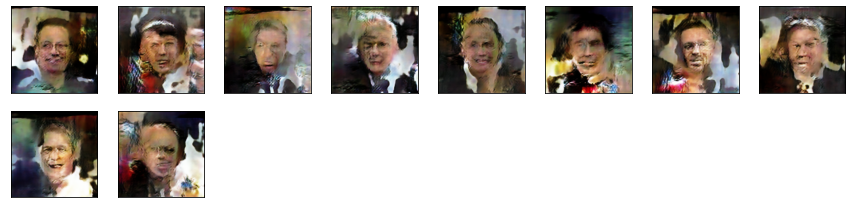

[Step 48500] D Loss: 0.1799; G Loss: 2.1605


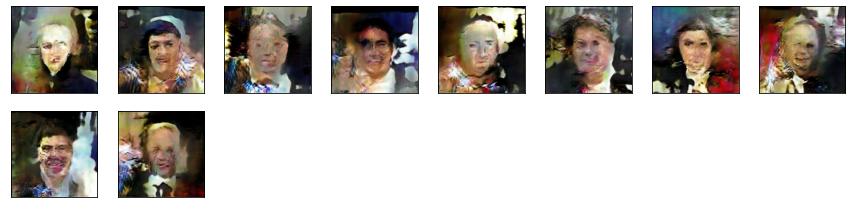

[Step 49000] D Loss: 0.1785; G Loss: 2.1726


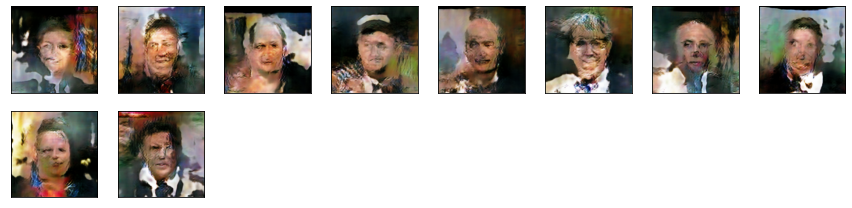

[Step 49500] D Loss: 0.3981; G Loss: 2.0486


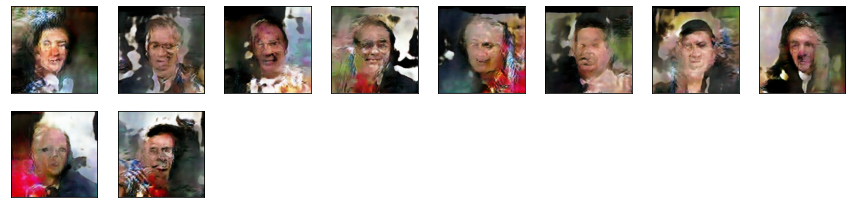

[Step 50000] D Loss: 0.3219; G Loss: 1.8228


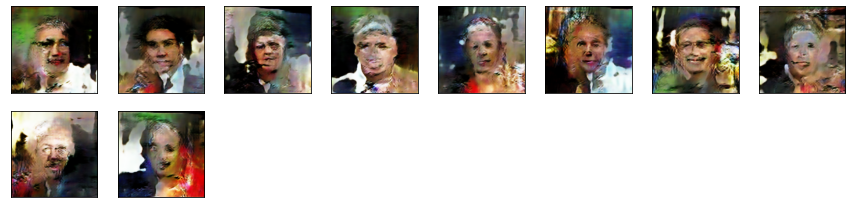

[Step 50500] D Loss: 0.2588; G Loss: 1.8522


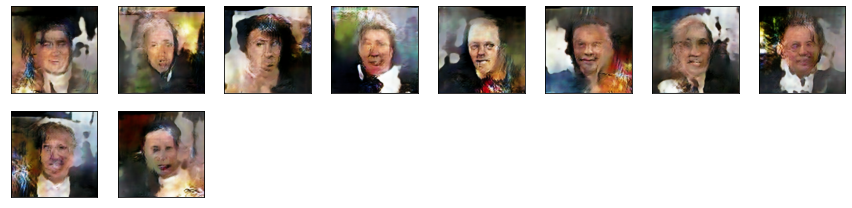

[Step 51000] D Loss: 1.0395; G Loss: 1.8160


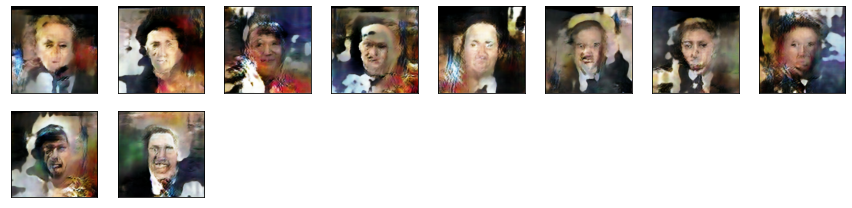

[Step 51500] D Loss: 0.3943; G Loss: 2.0459


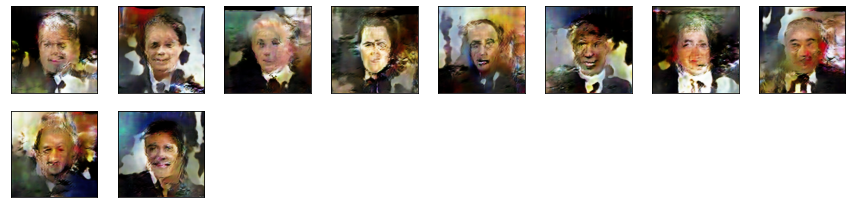

[Step 52000] D Loss: 0.6650; G Loss: 2.0556


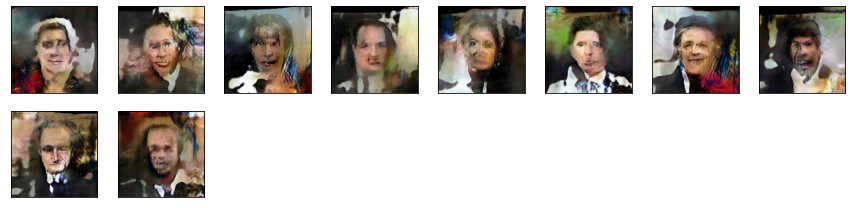

[Step 52500] D Loss: 0.7161; G Loss: 2.0421


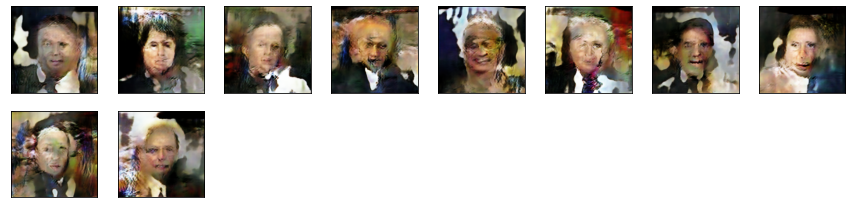

Wall time: 3h 35min 16s


In [25]:
%%time
for step, true_images in enumerate(train_x):
    
    # Train Discriminator
    
    noise = np.random.normal(0, 1, (HALF_BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    syntetic_images = generator.predict(noise)
    x_combined = np.concatenate((
        true_images, 
        syntetic_images))
    y_combined = np.concatenate((
        np.ones((HALF_BATCH_SIZE, 1), np.float32), 
        np.zeros((HALF_BATCH_SIZE, 1), np.float32)))
    
    with tf.GradientTape() as tape:
        logits = discriminator(x_combined, training=True)
        d_loss_value = sigmoid_cross_entropy(y_combined, logits)
    grads = tape.gradient(d_loss_value, discriminator.trainable_variables)
    optimizer.apply_gradients(zip(grads, discriminator.trainable_variables))
    
    # Train Generator
    
    noise = np.random.normal(0, 1, (BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    y_mislabled = np.ones((BATCH_SIZE, 1), np.float32)
    
    with tf.GradientTape() as tape:
        syntetic = generator(noise, training=True)
        logits = discriminator(syntetic, training=False)
        g_loss_value = sigmoid_cross_entropy(y_mislabled, logits)
    grads = tape.gradient(g_loss_value, generator.trainable_variables)
    optimizer.apply_gradients(zip(grads, generator.trainable_variables))
    
    # Check intermediate results
    
    if step % 500 == 0:
        print('[Step %2d] D Loss: %.4f; G Loss: %.4f' % (
            step, d_loss_value.numpy(), g_loss_value.numpy()))
        noise = np.random.normal(0, 1, (8, INPUT_DIM)).astype(np.float32)
#         syntetic_images = generator.predict(noise)
        syntetic_images = (syntetic.numpy()*127.5)+127.5
        syntetic_images = syntetic_images.astype(int)
        plot_digits(syntetic_images)

## Тестирование свёрточного генератора

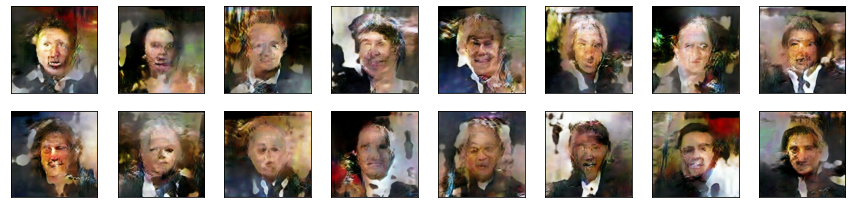

In [29]:
noise = np.random.normal(0, 1, (16, INPUT_DIM)).astype(np.float32)
syntetic_images = generator.predict(noise)
syntetic_images = (syntetic_images*127.5)+127.5
syntetic_images = syntetic_images.astype(int)
plot_digits(syntetic_images)

## Интерполяция в латентном пространстве

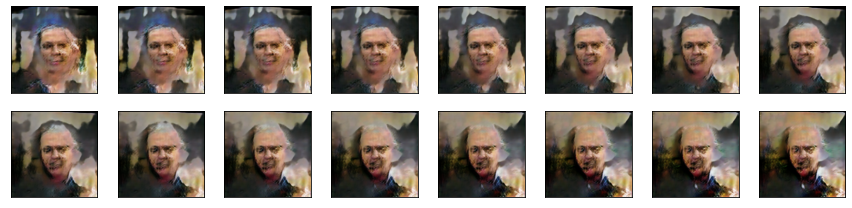

In [37]:
noise_1 = np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise_2 = np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise = np.linspace(noise_1, noise_2, 16)
syntetic_images = generator.predict(noise)
syntetic_images = (syntetic_images*127.5)+127.5
syntetic_images = syntetic_images.astype(int)
plot_digits(syntetic_images)